In [ ]:
!pip install seaborn
!pip install shap
!pip install lime

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.feature_selection import mutual_info_classif
from sklearn.ensemble import RandomForestClassifier

datasets = ['unique_alexnet_grafico_train.csv','unique_caffenet_grafico_train.csv', 'unique_googlenet_grafico_train.csv', 'unique_transfer_alexnet_grafico_train.csv', 'unique_transfer_caffenet_grafico_train.csv', 'unique_transfer_googlenet_grafico_train.csv' ]

classif = RandomForestClassifier(random_state=3, n_jobs=-1)

for i, dtName in enumerate(datasets):
    
    nameModel = ""
    
    if i == 0:
        nameModel = "Alexnet"

    elif i == 1:
        nameModel = "Caffenet"

    elif i == 2:
        nameModel = "Googlenet"
        
    elif i == 3:
        nameModel = "Alexnet With Transfer Learning"

    elif i == 4:
        nameModel = "Caffenet With Transfer Learning"

    else:
        nameModel = "Googlenet With Transfer Learning"
    
    print(dtName)
    
    print(dtName)

    # Carregar o dataset a partir de um arquivo CSV
    dataset = pd.read_csv('./dataset/'+dtName)

    # Separar as features e a classe
    X = dataset.drop('classe', axis=1)
    y = dataset['classe']

    # Calcular a importância das features usando a Informação Mútua
    # feature_importance = mutual_info_classif(X, y)
    feature_importance = classif.fit(X,y).feature_importances_

    # Visualizar os resultados em um gráfico de barras
    plt.figure(figsize=(10, 6))
    plt.bar(X.columns, feature_importance)
    plt.xlabel('Features')
    plt.ylabel('Mutual Information')
    plt.title('Feature Importance (Mutual Information)')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.feature_selection import mutual_info_classif
from sklearn.ensemble import RandomForestClassifier

datasets = ['unique_alexnet_grafico_train.csv','unique_caffenet_grafico_train.csv', 'unique_googlenet_grafico_train.csv', 'unique_transfer_alexnet_grafico_train.csv', 'unique_transfer_caffenet_grafico_train.csv', 'unique_transfer_googlenet_grafico_train.csv' ]

for i, dtName in enumerate(datasets):
    
    nameModel = ""
    
    if i == 0:
        nameModel = "Alexnet"

    elif i == 1:
        nameModel = "Caffenet"

    elif i == 2:
        nameModel = "Googlenet"
        
    elif i == 3:
        nameModel = "Alexnet With Transfer Learning"

    elif i == 4:
        nameModel = "Caffenet With Transfer Learning"

    else:
        nameModel = "Googlenet With Transfer Learning"
    
    print(dtName)

    # Carregar o dataset a partir de um arquivo CSV
    dataset = pd.read_csv('./dataset/'+dtName)

    # Separar as features e a classe
    X = dataset.drop('classe', axis=1)
    y = dataset['classe']

    # Calcular a importância das features usando a Informação Mútua
    feature_importance = mutual_info_classif(X, y)

    # Visualizar os resultados em um gráfico de barras
    plt.figure(figsize=(10, 6))
    plt.bar(X.columns, feature_importance)
    plt.xlabel('Features')
    plt.ylabel('Mutual Information')
    plt.title('Feature Importance ' + nameModel + ' (Mutual Information)')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()
    
    print(dataset.describe().T)
    
    dataset_features = dataset.drop("classe", axis=1)
    
    print(dataset_features.corr())
    
    fig, ax = plt.subplots(figsize=(5, 5))

    sns.heatmap(dataset_features.corr(method="pearson"), ax=ax, annot=True, cmap="rocket", cbar=False)

In [ ]:
# Load useful libraries
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report

datasets = ['unique_alexnet_grafico_train.csv','unique_caffenet_grafico_train.csv', 'unique_googlenet_grafico_train.csv', 'unique_transfer_alexnet_grafico_train.csv', 'unique_transfer_caffenet_grafico_train.csv', 'unique_transfer_googlenet_grafico_train.csv' ]

for i, dtName in enumerate(datasets):
    
    nameModel = ""
    
    if i == 0:
        nameModel = "Alexnet"

    elif i == 1:
        nameModel = "Caffenet"

    elif i == 2:
        nameModel = "Googlenet"
        
    elif i == 3:
        nameModel = "Alexnet With Transfer Learning"

    elif i == 4:
        nameModel = "Caffenet With Transfer Learning"

    else:
        nameModel = "Googlenet With Transfer Learning"
    
    
    
    # Carregar o dataset a partir de um arquivo CSV
    dataset = pd.read_csv('./dataset/'+dtName)
    
    # Separate Features and Target Variables

    X = dataset.drop(columns='classe')
    y = dataset['classe']

    # Create Train & Test Data
    X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.3,
                                                        stratify =y,
                                                        random_state = 13)

    # Build the model
    rf_clf = RandomForestClassifier(max_features=2, n_estimators =100 ,bootstrap = True)

    rf_clf.fit(X_train, y_train)

    # Make prediction on the testing data
    y_pred = rf_clf.predict(X_test)

    # Classification Report
    print(classification_report(y_pred, y_test))
    
    import shap
    import matplotlib.pyplot as plt
    from tqdm import tqdm

    # load JS visualization code to notebook
    shap.initjs()

    # Create the explainer
    explainer = shap.TreeExplainer(rf_clf)

    shap_values = explainer.shap_values(X_test)
    
    print("Variable Importance Plot - Global Interpretation")
    figure = plt.figure()
    shap.summary_plot(shap_values, X_test)
    
    shap.summary_plot(shap_values[1], X_test)

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from lime.lime_tabular import LimeTabularExplainer

# Carregar o conjunto de dados Iris
from sklearn.datasets import load_iris
data = load_iris()
X = data.data
y = data.target
feature_names = data.feature_names
print(feature_names)
print(type(feature_names))

# Dividir os dados em treinamento e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Treinar um modelo de RandomForest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

print(X_train)

# Inicializar o LimeTabularExplainer
explainer = LimeTabularExplainer(X_train, mode="classification", feature_names=feature_names)

# Selecionar uma instância de teste para explicação
instance_to_explain = X_test[0]

# Explicar a previsão do modelo para a instância selecionada
explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)

# Imprimir as explicações
explanation.show_in_notebook()

In [ ]:
# Lime Explainable AI - Video 819
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from lime.lime_tabular import LimeTabularExplainer
import matplotlib.pyplot as plt


#datasets = ['unique_alexnet_grafico_train.csv']
datasets = ['unique_alexnet_grafico_train.csv','unique_caffenet_grafico_train.csv', 'unique_googlenet_grafico_train.csv', 'unique_transfer_alexnet_grafico_train.csv', 'unique_transfer_caffenet_grafico_train.csv', 'unique_transfer_googlenet_grafico_train.csv' ]


for i, dtName in enumerate(datasets):
 
    nameModel = ""
    dtTest = ""
    if i == 0:
        nameModel = "Alexnet"
        dtTest = "alexnet_819.csv"

    elif i == 1:
        nameModel = "Caffenet"
        dtTest = "caffenet_819.csv"

    elif i == 2:
        nameModel = "Googlenet"
        dtTest = "googlenet_819.csv"
        
    elif i == 3:
        nameModel = "Alexnet With Transfer Learning"
        dtTest = "transfer_alexnet_819.csv"

    elif i == 4:
        nameModel = "Caffenet With Transfer Learning"
        dtTest = "transfer_caffenet_819.csv"
    else:
        nameModel = "Googlenet With Transfer Learning"
        dtTest = "transfer_googlenet_819.csv"
            
    # Carregar o dataset a partir de um arquivo CSV
    dataset = pd.read_csv('./dataset/'+dtName)
    
    # Separate Features and Target Variables

    x_label = dataset.drop(columns='classe')
    X = dataset.iloc[:,:-1].values
    y = dataset['classe']
    
    feature_names = x_label.columns.tolist()
    print(feature_names)

    # Create Train & Test Data
    x_train, x_test, y_train, y_test = train_test_split(X, y,test_size=0.3,
                                                        stratify =y,
                                                        random_state = 13)
    

    # Treinar um modelo de RandomForest
    model = RandomForestClassifier(n_estimators=100, random_state=42)
    #print(x_train)
    model.fit(x_train, y_train)
    
    #print(type(feature_names))
    
    # Make prediction on the testing data
    y_pred = model.predict(x_test)
    print("")
    print("### "+nameModel+" ###")
    # Classification Report
    print(classification_report(y_pred, y_test))

    # Inicializar o LimeTabularExplainer
    explainer = LimeTabularExplainer(x_train, mode="classification", feature_names=feature_names)

    
    # Carregar Dataset de Teste - vídeo 819
    datasetTeste = pd.read_csv('./dataset/'+dtTest)
    x_test_video = datasetTeste.iloc[:,:-1].values
    
    print("### "+nameModel+"-Frame 1 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[73]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 2 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[76]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 3 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[77]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 4 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[78]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 5 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[83]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()

    

In [ ]:
# Lime Explainable AI - Video 1298
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from lime.lime_tabular import LimeTabularExplainer
import matplotlib.pyplot as plt


#datasets = ['unique_alexnet_grafico_train.csv']
datasets = ['unique_alexnet_grafico_train.csv','unique_caffenet_grafico_train.csv', 'unique_googlenet_grafico_train.csv', 'unique_transfer_alexnet_grafico_train.csv', 'unique_transfer_caffenet_grafico_train.csv', 'unique_transfer_googlenet_grafico_train.csv' ]


for i, dtName in enumerate(datasets):
 
    nameModel = ""
    dtTest = ""
    if i == 0:
        nameModel = "Alexnet"
        dtTest = "alexnet_1298.csv"

    elif i == 1:
        nameModel = "Caffenet"
        dtTest = "caffenet_1298.csv"

    elif i == 2:
        nameModel = "Googlenet"
        dtTest = "googlenet_1298.csv"
        
    elif i == 3:
        nameModel = "Alexnet With Transfer Learning"
        dtTest = "transfer_alexnet_1298.csv"

    elif i == 4:
        nameModel = "Caffenet With Transfer Learning"
        dtTest = "transfer_caffenet_1298.csv"
    else:
        nameModel = "Googlenet With Transfer Learning"
        dtTest = "transfer_googlenet_1298.csv"
            
    # Carregar o dataset a partir de um arquivo CSV
    dataset = pd.read_csv('./dataset/'+dtName)
    
    # Separate Features and Target Variables

    x_label = dataset.drop(columns='classe')
    X = dataset.iloc[:,:-1].values
    y = dataset['classe']
    
    feature_names = x_label.columns.tolist()
    print(feature_names)

    # Create Train & Test Data
    x_train, x_test, y_train, y_test = train_test_split(X, y,test_size=0.3,
                                                        stratify =y,
                                                        random_state = 13)
    

    # Treinar um modelo de RandomForest
    model = RandomForestClassifier(n_estimators=100, random_state=42)
    #print(x_train)
    model.fit(x_train, y_train)
    
    #print(type(feature_names))
    
    # Make prediction on the testing data
    y_pred = model.predict(x_test)
    print("")
    print("### "+nameModel+" ###")
    # Classification Report
    print(classification_report(y_pred, y_test))

    # Inicializar o LimeTabularExplainer
    explainer = LimeTabularExplainer(x_train, mode="classification", feature_names=feature_names)

    
    # Carregar Dataset de Teste - vídeo 1298
    datasetTeste = pd.read_csv('./dataset/'+dtTest)
    x_test_video = datasetTeste.iloc[:,:-1].values
    
    print("### "+nameModel+"-Frame 1 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[8]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 2 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[75]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 3 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[175]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 4 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[201]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 5 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[245]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()


In [ ]:
# Lime Explainable AI - Video 1325
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from lime.lime_tabular import LimeTabularExplainer
import matplotlib.pyplot as plt


#datasets = ['unique_alexnet_grafico_train.csv']
datasets = ['unique_alexnet_grafico_train.csv','unique_caffenet_grafico_train.csv', 'unique_googlenet_grafico_train.csv', 'unique_transfer_alexnet_grafico_train.csv', 'unique_transfer_caffenet_grafico_train.csv', 'unique_transfer_googlenet_grafico_train.csv' ]


for i, dtName in enumerate(datasets):
 
    nameModel = ""
    dtTest = ""
    if i == 0:
        nameModel = "Alexnet"
        dtTest = "alexnet_1325.csv"

    elif i == 1:
        nameModel = "Caffenet"
        dtTest = "caffenet_1325.csv"

    elif i == 2:
        nameModel = "Googlenet"
        dtTest = "googlenet_1325.csv"
        
    elif i == 3:
        nameModel = "Alexnet With Transfer Learning"
        dtTest = "transfer_alexnet_1325.csv"

    elif i == 4:
        nameModel = "Caffenet With Transfer Learning"
        dtTest = "transfer_caffenet_1325.csv"
    else:
        nameModel = "Googlenet With Transfer Learning"
        dtTest = "transfer_googlenet_1325.csv"
            
    # Carregar o dataset a partir de um arquivo CSV
    dataset = pd.read_csv('./dataset/'+dtName)
    
    # Separate Features and Target Variables

    x_label = dataset.drop(columns='classe')
    X = dataset.iloc[:,:-1].values
    y = dataset['classe']
    
    feature_names = x_label.columns.tolist()
    print(feature_names)

    # Create Train & Test Data
    x_train, x_test, y_train, y_test = train_test_split(X, y,test_size=0.3,
                                                        stratify =y,
                                                        random_state = 13)
    

    # Treinar um modelo de RandomForest
    model = RandomForestClassifier(n_estimators=100, random_state=42)
    #print(x_train)
    model.fit(x_train, y_train)
    
    #print(type(feature_names))
    
    # Make prediction on the testing data
    y_pred = model.predict(x_test)
    print("")
    print("### "+nameModel+" ###")
    # Classification Report
    print(classification_report(y_pred, y_test))

    # Inicializar o LimeTabularExplainer
    explainer = LimeTabularExplainer(x_train, mode="classification", feature_names=feature_names)

    
    # Carregar Dataset de Teste - vídeo 1325
    datasetTeste = pd.read_csv('./dataset/'+dtTest)
    x_test_video = datasetTeste.iloc[:,:-1].values
    
    print("### "+nameModel+"-Frame 1 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[603]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 2 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[606]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 3 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[610]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 4 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[611]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 5 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[617]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()


In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from lime.lime_tabular import LimeTabularExplainer

data = pd.read_csv('./dataset/unique_alexnet_grafico_train.csv')
print(data.head())

x_name = data.drop(columns='classe')
y = data['classe']

X = data.iloc[:,:-1].values
#y = data.loc[y]
feature_names = x_name.columns.tolist()

# Dividir os dados em treinamento e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Treinar um modelo de RandomForest
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Inicializar o LimeTabularExplainer
explainer = LimeTabularExplainer(X_train, mode="classification", feature_names=feature_names)

# Selecionar uma instância de teste para explicação
instance_to_explain = X_test[0]

# Explicar a previsão do modelo para a instância selecionada
explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)

# Imprimir as explicações
explanation.show_in_notebook()

In [ ]:
import caffe
import numpy as np
import tensorflow as tf
from lime import lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image

# Carregar o modelo treinado no Caffe
caffe_model_path = 'caminho/para/seu/modelo.caffemodel'
caffe_prototxt_path = 'caminho/para/seu/arquivo.prototxt'
caffe.set_mode_cpu()
net = caffe.Net(caffe_prototxt_path, caffe_model_path, caffe.TEST)

# Converter o modelo Caffe para TensorFlow
# Aqui você precisará converter as camadas do modelo Caffe para camadas equivalentes no TensorFlow

# Função para preprocessar a imagem
def preprocess_image(image_path):
    img = image.load_img(image_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    return img_array

# Função para fazer previsões usando o modelo Caffe
def caffe_predict(images):
    net.blobs['data'].data[...] = images.transpose(0, 3, 1, 2)
    net.forward()
    predictions = net.blobs['prob'].data
    return predictions

# Carregar uma imagem de exemplo
img_path = 'caminho/para/sua/imagem.jpg'
img_array = preprocess_image(img_path)

# Criar um explicador LIME para imagens
explainer = lime_image.LimeImageExplainer()

# Explicar a previsão usando a função de previsão do Caffe
explanation = explainer.explain_instance(img_array, caffe_predict, top_labels=5, hide_color=0, num_samples=1000)

# Obter as imagens explicativas
temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)
plt.figure(figsize=(8, 8))
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))
plt.title("Explicação LIME para a Previsão")
plt.axis('off')
plt.show()


In [ ]:
!pip install python-caffe

In [ ]:
!pip install mmdnn

['Predict Base', 'Probability Interval', 'Probability Previous', 'Probability Next', 'Time Previous', 'Time Next']

### Alexnet ###
              precision    recall  f1-score   support

           0       0.99      0.98      0.99      9570
           1       0.96      0.98      0.97      4659

    accuracy                           0.98     14229
   macro avg       0.98      0.98      0.98     14229
weighted avg       0.98      0.98      0.98     14229

### Alexnet-Frame 1 ###


### Alexnet-Frame 2 ###


### Alexnet-Frame 3 ###


### Alexnet-Frame 4 ###


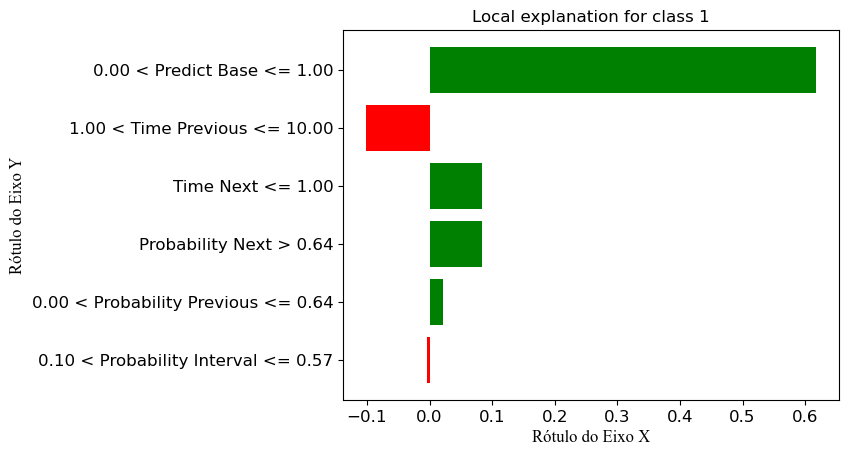

['Predict Base', 'Probability Interval', 'Probability Previous', 'Probability Next', 'Time Previous', 'Time Next']

### Caffenet ###
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      9483
           1       1.00      1.00      1.00      4746

    accuracy                           1.00     14229
   macro avg       1.00      1.00      1.00     14229
weighted avg       1.00      1.00      1.00     14229

### Caffenet-Frame 1 ###


### Caffenet-Frame 2 ###


### Caffenet-Frame 3 ###


### Caffenet-Frame 4 ###


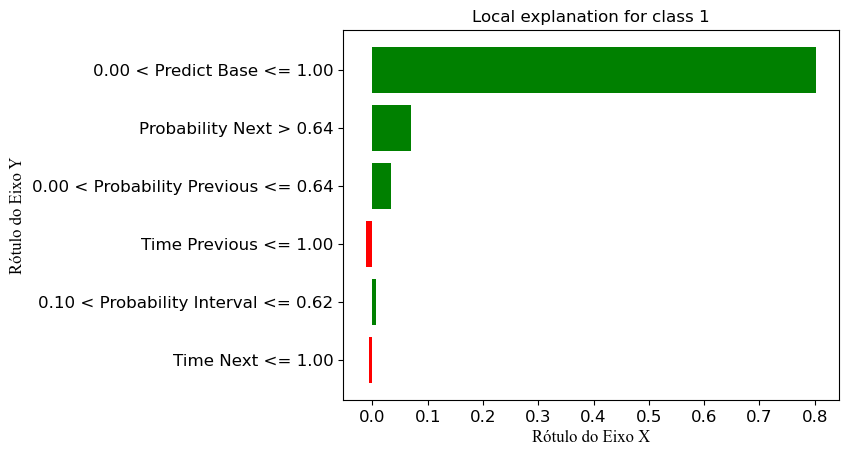

['Predict Base', 'Probability Interval', 'Probability Previous', 'Probability Next', 'Time Previous', 'Time Next']

### Googlenet ###
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      9539
           1       0.95      0.96      0.96      4690

    accuracy                           0.97     14229
   macro avg       0.97      0.97      0.97     14229
weighted avg       0.97      0.97      0.97     14229

### Googlenet-Frame 1 ###


### Googlenet-Frame 2 ###


### Googlenet-Frame 3 ###


### Googlenet-Frame 4 ###


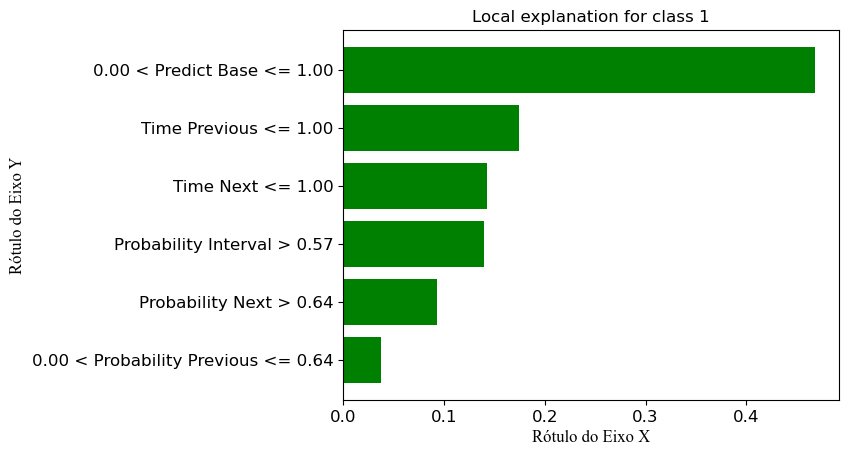

['Predict Base', 'Probability Interval', 'Probability Previous', 'Probability Next', 'Time Previous', 'Time Next']

### Alexnet With Transfer Learning ###
              precision    recall  f1-score   support

           0       1.00      0.99      0.99      9500
           1       0.99      0.99      0.99      4729

    accuracy                           0.99     14229
   macro avg       0.99      0.99      0.99     14229
weighted avg       0.99      0.99      0.99     14229

### Alexnet With Transfer Learning-Frame 1 ###


### Alexnet With Transfer Learning-Frame 2 ###


### Alexnet With Transfer Learning-Frame 3 ###


### Alexnet With Transfer Learning-Frame 4 ###


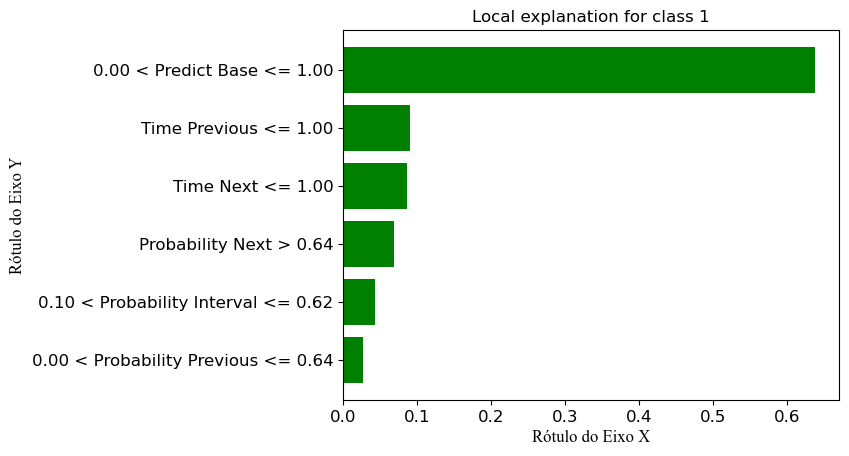

['Predict Base', 'Probability Interval', 'Probability Previous', 'Probability Next', 'Time Previous', 'Time Next']

### Caffenet With Transfer Learning ###
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      9473
           1       0.97      0.96      0.97      4756

    accuracy                           0.98     14229
   macro avg       0.97      0.97      0.97     14229
weighted avg       0.98      0.98      0.98     14229

### Caffenet With Transfer Learning-Frame 1 ###


### Caffenet With Transfer Learning-Frame 2 ###


### Caffenet With Transfer Learning-Frame 3 ###


### Caffenet With Transfer Learning-Frame 4 ###


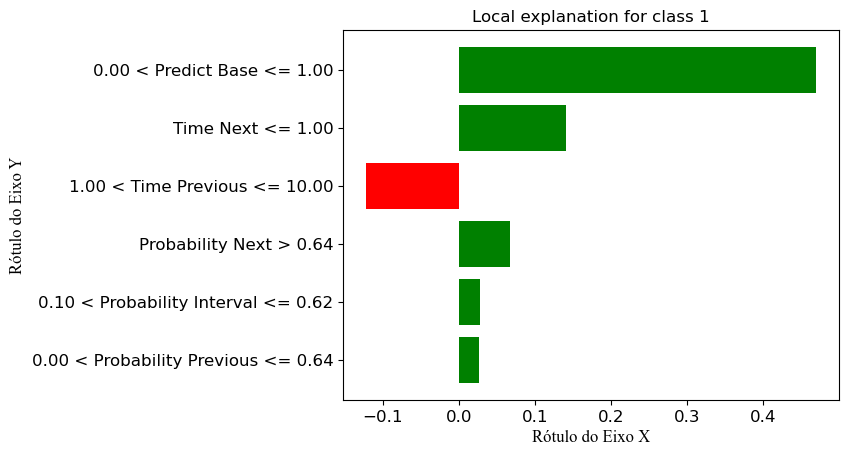

['Predict Base', 'Probability Interval', 'Probability Previous', 'Probability Next', 'Time Previous', 'Time Next']

### Googlenet With Transfer Learning ###
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9456
           1       0.99      0.98      0.99      4773

    accuracy                           0.99     14229
   macro avg       0.99      0.99      0.99     14229
weighted avg       0.99      0.99      0.99     14229

### Googlenet With Transfer Learning-Frame 1 ###


### Googlenet With Transfer Learning-Frame 2 ###


### Googlenet With Transfer Learning-Frame 3 ###


### Googlenet With Transfer Learning-Frame 4 ###


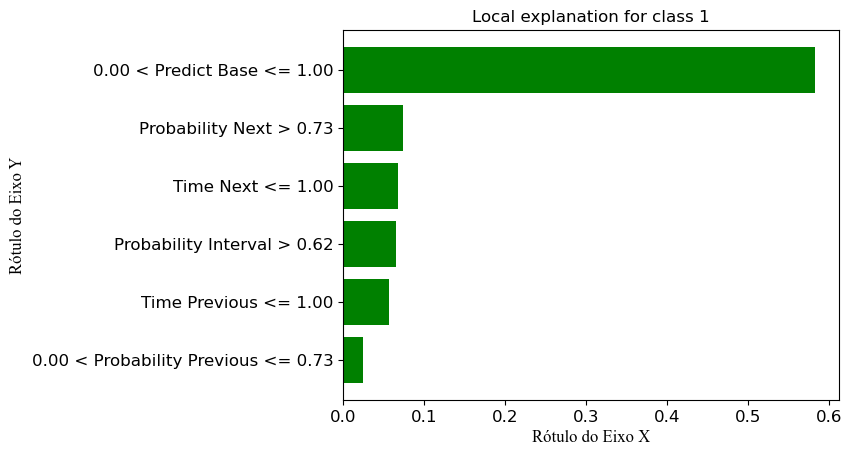

In [22]:
# Lime Explainable AI - Video 1325
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from lime.lime_tabular import LimeTabularExplainer
import matplotlib.pyplot as plt
from matplotlib.font_manager import FontProperties

#datasets = ['unique_alexnet_grafico_train.csv']
datasets = ['unique_alexnet_grafico_train.csv','unique_caffenet_grafico_train.csv', 'unique_googlenet_grafico_train.csv', 'unique_transfer_alexnet_grafico_train.csv', 'unique_transfer_caffenet_grafico_train.csv', 'unique_transfer_googlenet_grafico_train.csv' ]


for i, dtName in enumerate(datasets):
 
    nameModel = ""
    dtTest = ""
    if i == 0:
        nameModel = "Alexnet"
        dtTest = "alexnet_819.csv"

    elif i == 1:
        nameModel = "Caffenet"
        dtTest = "caffenet_819.csv"

    elif i == 2:
        nameModel = "Googlenet"
        dtTest = "googlenet_819.csv"
        
    elif i == 3:
        nameModel = "Alexnet With Transfer Learning"
        dtTest = "transfer_alexnet_819.csv"

    elif i == 4:
        nameModel = "Caffenet With Transfer Learning"
        dtTest = "transfer_caffenet_819.csv"
    else:
        nameModel = "Googlenet With Transfer Learning"
        dtTest = "transfer_googlenet_819.csv"
            
    # Carregar o dataset a partir de um arquivo CSV
    dataset = pd.read_csv('./dataset/'+dtName)
    
    # Separate Features and Target Variables

    x_label = dataset.drop(columns='classe')
    X = dataset.iloc[:,:-1].values
    y = dataset['classe']
    
    feature_names = x_label.columns.tolist()
    print(feature_names)

    # Create Train & Test Data
    x_train, x_test, y_train, y_test = train_test_split(X, y,test_size=0.3,
                                                        stratify =y,
                                                        random_state = 13)
    

    # Treinar um modelo de RandomForest
    model = RandomForestClassifier(n_estimators=100, random_state=42)
    #print(x_train)
    model.fit(x_train, y_train)
    
    #print(type(feature_names))
    
    # Make prediction on the testing data
    y_pred = model.predict(x_test)
    print("")
    print("### "+nameModel+" ###")
    # Classification Report
    print(classification_report(y_pred, y_test))

    # Inicializar o LimeTabularExplainer
    explainer = LimeTabularExplainer(x_train, mode="classification", feature_names=feature_names, class_names=None)

    
    # Carregar Dataset de Teste - vídeo 1325
    datasetTeste = pd.read_csv('./dataset/'+dtTest)
    x_test_video = datasetTeste.iloc[:,:-1].values
    
    print("### "+nameModel+"-Frame 1 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[78]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 2 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[79]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 3 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[80]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)
    
    # Adicionar um título à explicação
    explanation.show_in_notebook()

    plt.show()
    
    
    print("### "+nameModel+"-Frame 4 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[81]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba, top_labels=None, labels=(1, ))
    
    plt.style.context("ggplot")

    fig = explanation.as_pyplot_figure()
    #fig.suptitle("Explication LIME")
    #plt.axis('off')
    
    
    custom_font = FontProperties(family='Times New Roman', size=12)
    plt.xlabel("Rótulo do Eixo X",fontproperties=custom_font)
    plt.ylabel("Rótulo do Eixo Y",fontproperties=custom_font)
    
    for tick in fig.get_axes()[0].get_xticklabels():
        tick.set_fontsize(12)
    
    for tick in fig.get_axes()[0].get_yticklabels():
        tick.set_fontsize(12)
        
    for text in fig.texts:
        text.set_visible(False)
        

    plt.grid(False)
    

    
    

    # Adicionar um título à explicação
    explanation.show_in_notebook()
    
    
    fig.savefig('lime_report.jpg')

    plt.show()
    
    
   

['Predict Base', 'Probability Interval', 'Probability Previous', 'Probability Next', 'Time Previous', 'Time Next']

### Googlenet ###
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      9539
           1       0.95      0.96      0.96      4690

    accuracy                           0.97     14229
   macro avg       0.97      0.97      0.97     14229
weighted avg       0.97      0.97      0.97     14229

### Googlenet-Frame 1 ###
['Predict Base', 'Probability Interval', 'Probability Previous', 'Probability Next', 'Time Previous', 'Time Next']

### Googlenet ###
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      9539
           1       0.95      0.96      0.96      4690

    accuracy                           0.97     14229
   macro avg       0.97      0.97      0.97     14229
weighted avg       0.97      0.97      0.97     14229

### Googlenet-Frame 1 ###
['Predict Base', 'Probabil

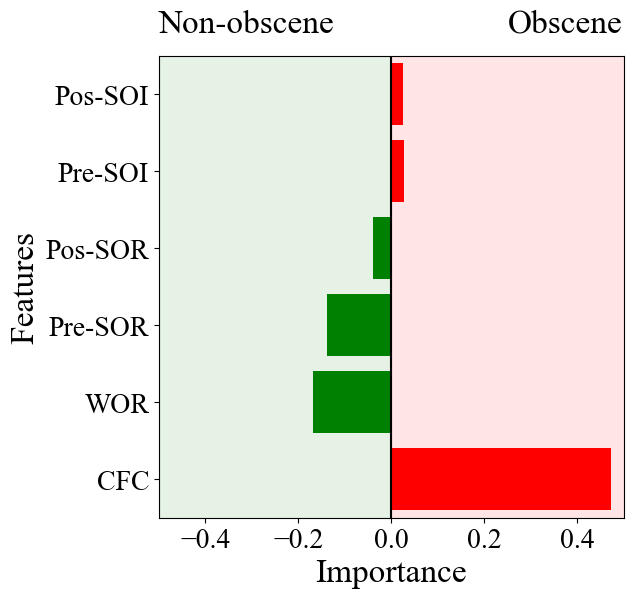

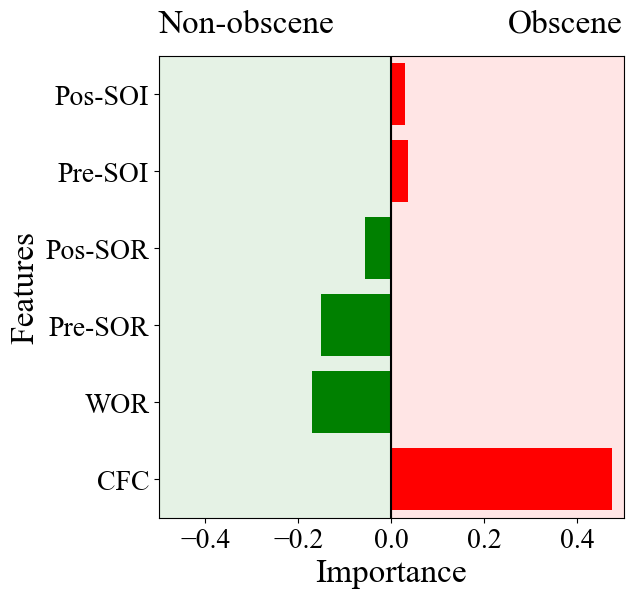

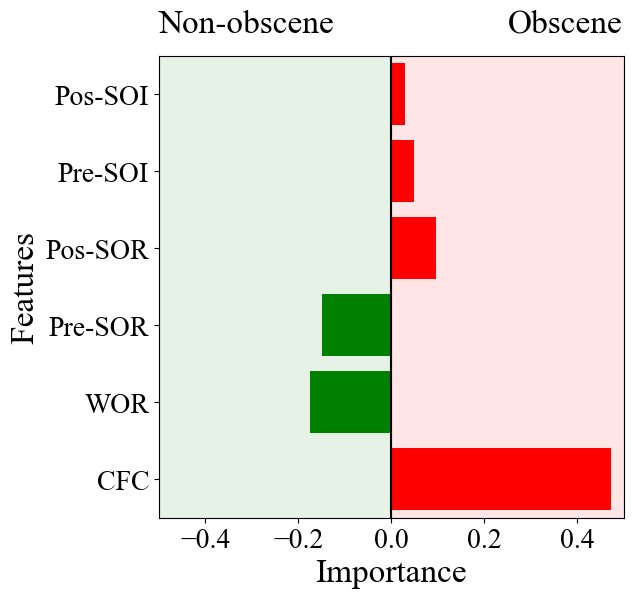

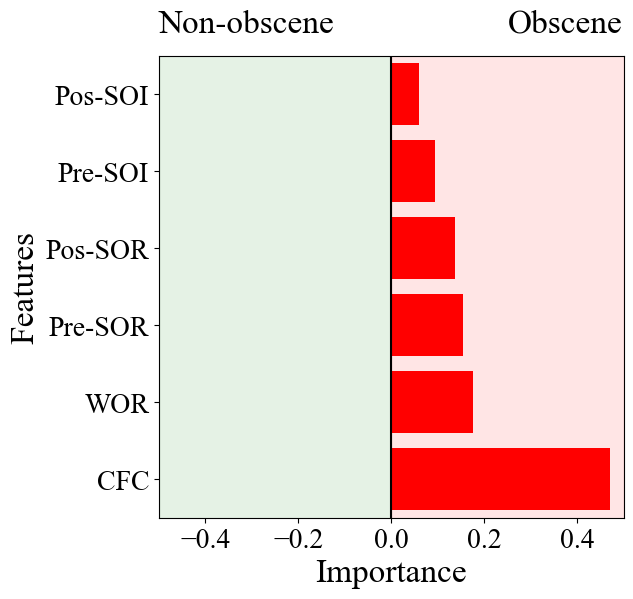

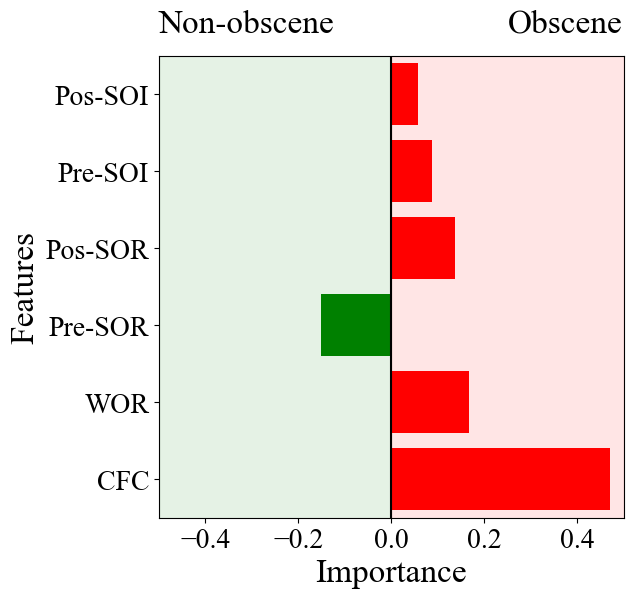

In [2]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from lime.lime_tabular import LimeTabularExplainer
import matplotlib.pyplot as plt
from matplotlib.font_manager import FontProperties
from matplotlib.patches import Rectangle

datasets = ['unique_googlenet_grafico_train.csv']
#datasets = ['unique_alexnet_grafico_train.csv','unique_caffenet_grafico_train.csv', 'unique_googlenet_grafico_train.csv', 'unique_transfer_alexnet_grafico_train.csv', 'unique_transfer_caffenet_grafico_train.csv', 'unique_transfer_googlenet_grafico_train.csv' ]

frames = [440, 443, 494, 518, 519]
#for j in range(0,700):
for j in frames:

    for i, dtName in enumerate(datasets):

        # Selecionar Googlenet i = 2
        i = 2

        nameModel = ""
        dtTest = ""
        if i == 0:
            nameModel = "Alexnet"
            dtTest = "alexnet_819.csv"

        elif i == 1:
            nameModel = "Caffenet"
            dtTest = "caffenet_819.csv"

        elif i == 2:
            nameModel = "Googlenet"
            dtTest = "googlenet_1325.csv"

        elif i == 3:
            nameModel = "Alexnet With Transfer Learning"
            dtTest = "transfer_alexnet_819.csv"

        elif i == 4:
            nameModel = "Caffenet With Transfer Learning"
            dtTest = "transfer_caffenet_819.csv"
        else:
            nameModel = "Googlenet With Transfer Learning"
            dtTest = "transfer_googlenet_819.csv"

        # Carregar o dataset a partir de um arquivo CSV
        dataset = pd.read_csv('./dataset/'+dtName)

        # Separate Features and Target Variables

        x_label = dataset.drop(columns='classe')
        X = dataset.iloc[:,:-1].values
        y = dataset['classe']

        feature_names = x_label.columns.tolist()
        print(feature_names)

        # Create Train & Test Data
        x_train, x_test, y_train, y_test = train_test_split(X, y,test_size=0.3,
                                                            stratify =y,
                                                            random_state = 13)


        # Treinar um modelo de RandomForest
        model = RandomForestClassifier(n_estimators=100, random_state=42)
        #print(x_train)
        model.fit(x_train, y_train)

        #print(type(feature_names))

        # Make prediction on the testing data
        y_pred = model.predict(x_test)
        print("")
        print("### "+nameModel+" ###")
        # Classification Report
        print(classification_report(y_pred, y_test))

        # Inicializar o LimeTabularExplainer
        explainer = LimeTabularExplainer(x_train, mode="classification", feature_names=feature_names, class_names=None)


        # Carregar Dataset de Teste - vídeo 1325
        datasetTeste = pd.read_csv('./dataset/'+dtTest)
        x_test_video = datasetTeste.iloc[:,:-1].values

        print("### "+nameModel+"-Frame 1 ###")

        # Selecionar uma instância de teste para explicação
        #instance_to_explain = x_test[0]
        instance_to_explain = x_test_video[j]
        #instance_to_explain = x_test_video[79]
        #instance_to_explain = x_test_video[80]
        #instance_to_explain = x_test_video[81]


        # Explicar a previsão do modelo para a instância selecionada
        explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)

        # Obtenha os valores das features relevantes da explicação
        feature_values = explanation.as_list()

        # Extraia as features e os valores correspondentes
        features = [item[0] for item in feature_values]
        values = [item[1] for item in feature_values]

        # Crie um gráfico de barras
        plt.figure(figsize=(6, 6))  # Ajuste o tamanho do gráfico conforme necessário
        #plt.barh(features, values, color='skyblue')
        #colors = ['skyblue', 'salmon']
        colors = ['green', 'red']
        class_colors = [colors[0] if value < 0 else colors[1] for value in values]


        plt.barh(features, values, color=class_colors)

        #print(features)
        feature_names = x_label.columns.tolist()
        #print(feature_names)

        # Personalize os rótulos dos eixos Y com os nomes das features
        #plt.yticks(np.arange(len(features)), features)
        custom_font = FontProperties(family='Times New Roman', size=20)

        # feature_names_new = ['Predict Base', 'Probability Interval', 'Probability Previous', 'Probability Next', 'Time Previous', 'Time Next']
        #feature_names_new = ['Current Frame Confidence', 'Window Obscenity Rate', 'Preceding Segment Obscenity Rate', 'Proceeding Segment Obscenity Rate', 'Preceding Segment Obscenity Interval', 'Proceeding Segment Obscenity Interval']

        feature_names_new = ['CFC', 'WOR', 'Pre-SOR', 'Pos-SOR', 'Pre-SOI', 'Pos-SOI']


        #plt.yticks(np.arange(len(features)), feature_names, fontproperties=custom_font)
        plt.yticks(np.arange(len(features)), feature_names_new, fontproperties=custom_font)
        plt.xticks(fontproperties=custom_font)
        plt.xlim(-0.5,0.5)
        custom_font_title = FontProperties(family='Times New Roman', size=24)

        plt.xlabel('Importance',fontproperties=custom_font_title)
        plt.ylabel('Features',fontproperties=custom_font_title)
        #plt.title('Importância das Features (LIME)')

        plt.text(-0.5, 5.8, 'Non-obscene', fontproperties=custom_font_title)
        plt.text(0.25, 5.8, 'Obscene', fontproperties=custom_font_title)

        ax = plt.gca()
        ax.add_patch(Rectangle((-0.5, -0.8), 0.5, 8, alpha=0.1, color='green'))
        ax.add_patch(Rectangle((0, -0.8), 0.5, 8, alpha=0.1, color='red'))
        plt.plot([0,0], [-20, 20], color='black')
        plt.ylim(-0.5,5.5)

        #plt.xlabel("Rótulo do Eixo X",fontproperties=custom_font)
        #plt.ylabel("Rótulo do Eixo Y",fontproperties=custom_font)

        #for tick in fig.get_axes()[0].get_xticklabels():
            #tick.set_fontsize(20)

        #for tick in fig.get_axes()[0].get_yticklabels():
            #tick.set_fontsize(20)

        #plt.savefig('lime_explanation4.png', bbox_inches='tight', dpi=300)
        plt.savefig('LIMEADA_' + str(j) + ".pdf", format='pdf', bbox_inches='tight', dpi=600, transparent=True)

        #plt.show()
   

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from lime.lime_tabular import LimeTabularExplainer
import matplotlib.pyplot as plt
from matplotlib.font_manager import FontProperties

datasets = ['unique_alexnet_grafico_train.csv']
#datasets = ['unique_alexnet_grafico_train.csv','unique_caffenet_grafico_train.csv', 'unique_googlenet_grafico_train.csv', 'unique_transfer_alexnet_grafico_train.csv', 'unique_transfer_caffenet_grafico_train.csv', 'unique_transfer_googlenet_grafico_train.csv' ]


for i, dtName in enumerate(datasets):
 
    nameModel = ""
    dtTest = ""
    if i == 0:
        nameModel = "Alexnet"
        dtTest = "alexnet_819.csv"

    elif i == 1:
        nameModel = "Caffenet"
        dtTest = "caffenet_819.csv"

    elif i == 2:
        nameModel = "Googlenet"
        dtTest = "googlenet_819.csv"
        
    elif i == 3:
        nameModel = "Alexnet With Transfer Learning"
        dtTest = "transfer_alexnet_819.csv"

    elif i == 4:
        nameModel = "Caffenet With Transfer Learning"
        dtTest = "transfer_caffenet_819.csv"
    else:
        nameModel = "Googlenet With Transfer Learning"
        dtTest = "transfer_googlenet_819.csv"
            
    # Carregar o dataset a partir de um arquivo CSV
    dataset = pd.read_csv('./dataset/'+dtName)
    
    # Separate Features and Target Variables

    x_label = dataset.drop(columns='classe')
    X = dataset.iloc[:,:-1].values
    y = dataset['classe']
    
    feature_names = x_label.columns.tolist()
    print(feature_names)

    # Create Train & Test Data
    x_train, x_test, y_train, y_test = train_test_split(X, y,test_size=0.3,
                                                        stratify =y,
                                                        random_state = 13)
    

    # Treinar um modelo de RandomForest
    model = RandomForestClassifier(n_estimators=100, random_state=42)
    #print(x_train)
    model.fit(x_train, y_train)
    
    #print(type(feature_names))
    
    # Make prediction on the testing data
    y_pred = model.predict(x_test)
    print("")
    print("### "+nameModel+" ###")
    # Classification Report
    print(classification_report(y_pred, y_test))

    # Inicializar o LimeTabularExplainer
    explainer = LimeTabularExplainer(x_train, mode="classification", feature_names=feature_names, class_names=None)

    
    # Carregar Dataset de Teste - vídeo 1325
    datasetTeste = pd.read_csv('./dataset/'+dtTest)
    x_test_video = datasetTeste.iloc[:,:-1].values
    
    print("### "+nameModel+"-Frame 1 ###")
    
    # Selecionar uma instância de teste para explicação
    #instance_to_explain = x_test[0]
    instance_to_explain = x_test_video[78]
    

    # Explicar a previsão do modelo para a instância selecionada
    explanation = explainer.explain_instance(instance_to_explain, model.predict_proba)

    # Obtenha os valores das features relevantes da explicação
    #feature_values = explanation.as_list()

    # Extraia as features e os valores correspondentes
    #features = [item[0] for item in feature_values]
    #values = [item[1] for item in feature_values]

    # Crie um gráfico de barras
    plt.figure(figsize=(7, 6))  # Ajuste o tamanho do gráfico conforme necessário
    #plt.barh(features, values, color='skyblue')
    colors = ['skyblue', 'salmon']
    class_colors = [colors[0] if value < 0 else colors[1] for value in values]


    plt.barh(features, values, color=class_colors)
    
    #print(features)
    #feature_names = x_label.columns.tolist()
    #print(feature_names)
        
    # Personalize os rótulos dos eixos Y com os nomes das features
    #plt.yticks(np.arange(len(features)), features)
    #plt.yticks(np.arange(len(features)), feature_names)
    


    plt.xlabel('Importance')
    plt.ylabel('Features')
    #plt.title('Importância das Features (LIME)')
    
    
    
    custom_font = FontProperties(family='Times New Roman', size=12)
    #plt.xlabel("Rótulo do Eixo X",fontproperties=custom_font)
    #plt.ylabel("Rótulo do Eixo Y",fontproperties=custom_font)
    
    for tick in fig.get_axes()[0].get_xticklabels():
        tick.set_fontsize(12)
    
    for tick in fig.get_axes()[0].get_yticklabels():
        tick.set_fontsize(12)
        
    #plt.savefig('lime_explanation.png', bbox_inches='tight', dpi=300)
    plt.savefig('lime_explanation.pdf', format='pdf', bbox_inches='tight', dpi=300, transparent=True)
    

    plt.show()